# Caso de Negocio

`completar` 

# Importar, Instalar y Cargar

## Instalación de librerías 


Para mantener los entornos actualizados, se almacenan las librerías necesarias en un archivo de requerimientos. Para instalar las librerías necesarias, se ejecuta el siguiente comando:

```bash
# Creación de archivo de requerimientos
pip freeze > requirements.txt
```

```bash
# Instalación de librerías necesarias
pip install -r requirements.txt
```

## Importar librerías

In [2]:
pip install scikit-learn

Note: you may need to restart the kernel to use updated packages.


In [3]:
from PIL import Image
import os
import matplotlib.pyplot as plt
import json
import cv2
import numpy as np
from sklearn.cluster import KMeans
# from skimage import io, img_as_float
# from scipy.ndimage import median_filter
import numpy as np

## Cargar Las Imagenes

In [4]:
image_directory = "base"
images = []

for filename in os.listdir(image_directory):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        img = Image.open(os.path.join(image_directory, filename))
        images.append((filename, img))

## Cargar Bounding Boxes

In [5]:
with open('classificationDownload/classifications.json', 'r') as file:
    bounding_boxes = json.load(file)   

# Análisis Exploratorio de Datos

## Análisis del CSV

In [6]:
import pandas as pd
# from ydata_profiling import ProfileReport

# Cargar el archivo CSV
df = pd.read_csv('classificationDownload/classifications.csv')

/Users/nataliamassri/opt/anaconda3/envs/metodos/lib/python3.10/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


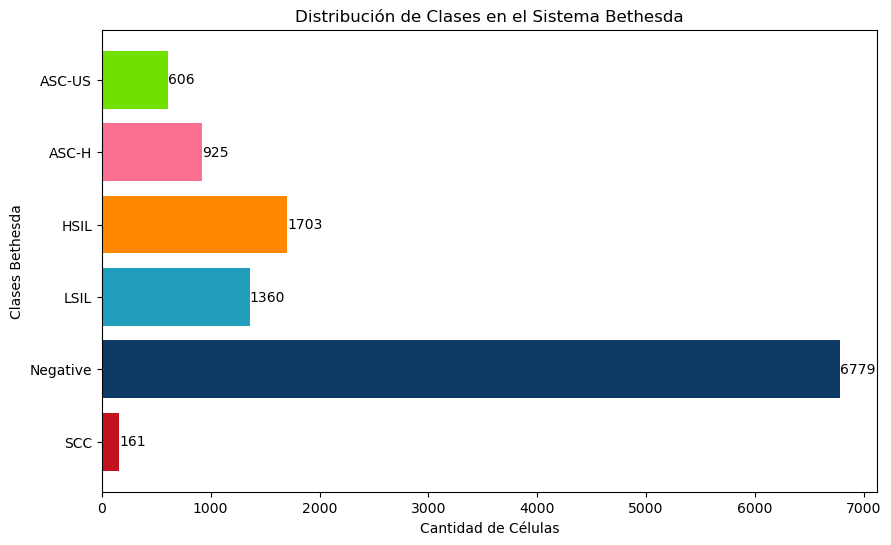

In [7]:
import json
import matplotlib.pyplot as plt

# Cargar los bounding boxes desde el archivo JSON
with open('classificationDownload/classifications.json', 'r') as file:
    bounding_boxes = json.load(file)

# Contar el número de instancias por clase Bethesda
class_counts = {}

for entry in bounding_boxes:
    classifications = entry['classifications']
    for classification in classifications:
        bethesda_system = classification['bethesda_system']
        
        # Ajustar el nombre de la clase "Negative for intraepithelial lesion" a "Negative"
        if bethesda_system == "Negative for intraepithelial lesion":
            bethesda_system = "Negative"
        
        if bethesda_system in class_counts:
            class_counts[bethesda_system] += 1
        else:
            class_counts[bethesda_system] = 1

# Colores asignados a cada clase Bethesda, con un color por defecto (gris) para clases no asignadas
class_colors = {
    'SCC': '#c1121f',  # Rojo
    'ASC-US': '#70e000',  # Verde
    'LSIL': '#219ebc',  # Celeste
    'HSIL': '#ff8800',  # Naranja
    'Negative': '#0d3b66',  # Negro
    'ASC-H': '#fb6f92'  # Rosa
}

# Preparar los datos para el gráfico de barras
labels = list(class_counts.keys())
sizes = list(class_counts.values())

# Asignar colores a cada barra según la clase o un color por defecto si no existe en el diccionario
colors = [class_colors.get(label, '#cccccc') for label in labels]  # Gris claro por defecto

# Gráfico de Barras Horizontal con colores personalizados
plt.figure(figsize=(10, 6))
bars = plt.barh(labels, sizes, color=colors)

# Añadir el número de células dentro de cada barra
for bar, size in zip(bars, sizes):
    plt.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height()/2,  # Posición
             str(size),  # Texto (número de células)
             va='center', ha='left', fontsize=10)  # Alineación vertical y horizontal

plt.title('Distribución de Clases en el Sistema Bethesda')
plt.xlabel('Cantidad de Células')
plt.ylabel('Clases Bethesda')
plt.show()

**Desbalance de Clases**

La clase con celulas `Negativas de lesiones intraepitelial`  domina claramente el dataset, representando la mayor proporción de células. Esto sugiere un desbalance significativo en el dataset.
Este desbalance puede afectar los modelos de clasificación. Los modelos pueden aprender a favorecer la clase dominante, lo que podría llevar a una clasificación incorrecta o baja precisión en las clases menos representadas.

## Análisis de Datos

### Bounding Box Tamaño Fijo 90x90

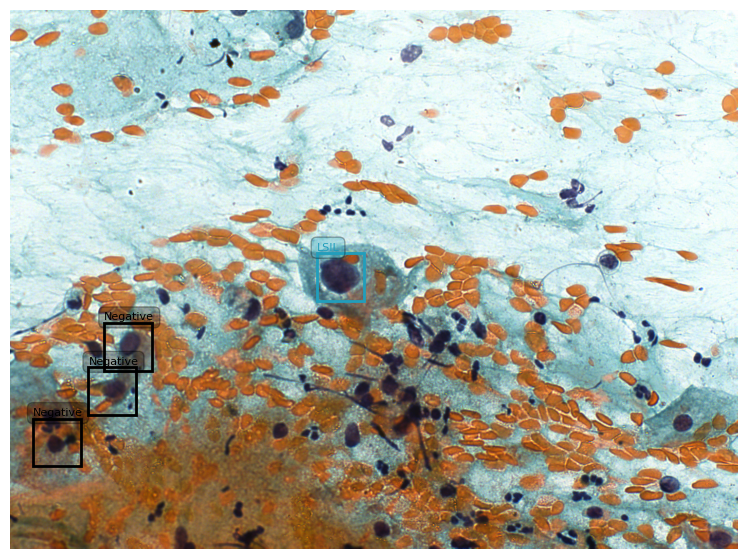

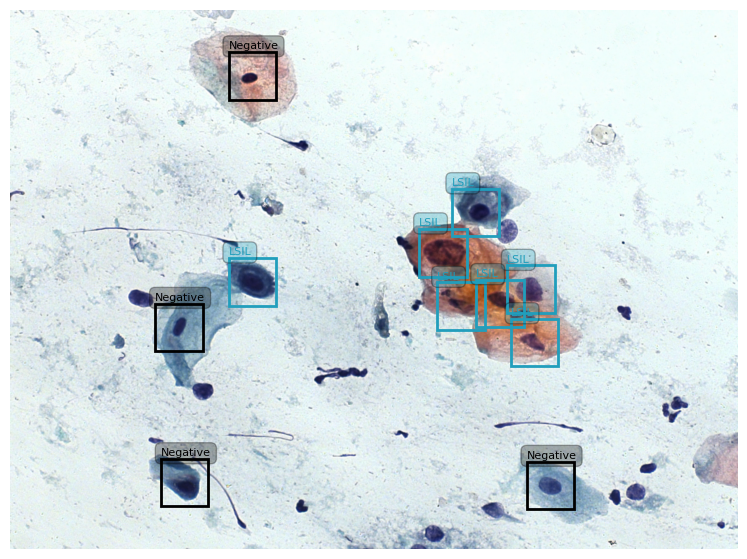

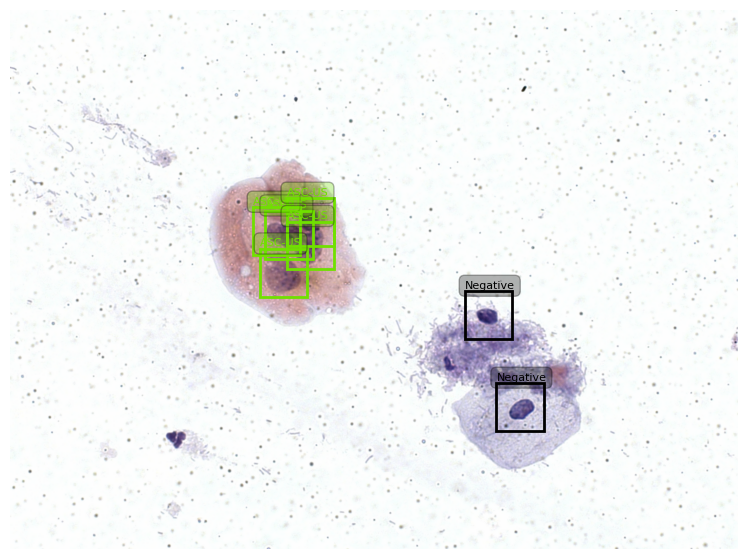

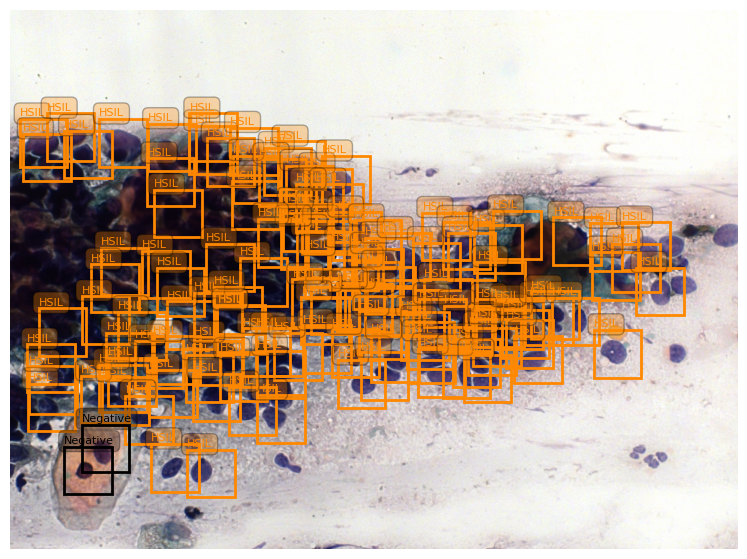

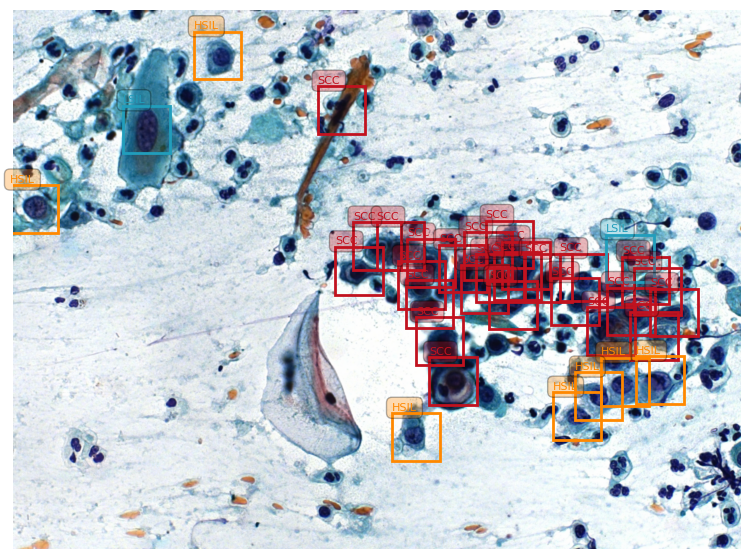

In [8]:
import os
import json
import matplotlib.pyplot as plt
from PIL import Image

# Cargar las imágenes desde el directorio
image_directory = "base"
images = []

for filename in os.listdir(image_directory):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        img = Image.open(os.path.join(image_directory, filename))
        images.append((filename, img))

# Limitar a las primeras 5 imágenes
images = images[:5]

# Cargar los bounding boxes desde el archivo JSON
with open('classificationDownload/classifications.json', 'r') as file:
    bounding_boxes = json.load(file)

# Diccionario de colores para clases
class_colors = {
    'SCC': '#c1121f',  # Rojo
    'ASC-US': '#70e000',  # Verde
    'LSIL': '#219ebc',  # Celeste
    'HSIL': '#ff8800',  # Naranja
    'ASC-H': '#fb6f92',  # Rosa
    'Negative for intraepithelial lesion': '#0d3b66',  # Azul Oscuro
}

# Función para ajustar el nombre de la clase "Negative for intraepithelial lesion" a "Negative"
def adjust_class_name(bethesda_system):
    if bethesda_system == 'Negative for intraepithelial lesion':
        return 'Negative'
    return bethesda_system

# Función para dibujar bounding boxes de tamaño fijo 90x90 píxeles con colores específicos
def draw_fixed_bounding_boxes(img, classifications):
    fig, ax = plt.subplots(1, figsize=(10, 7))
    ax.imshow(img)
    
    rect_width, rect_height = 90, 90  # Tamaño fijo del bounding box (90x90 píxeles)
    
    for classification in classifications:
        x_center = classification['nucleus_x']
        y_center = classification['nucleus_y']
        bethesda_system = adjust_class_name(classification['bethesda_system'])  # Ajustar nombre de clase
        
        # Calcular la esquina superior izquierda del bounding box
        x = x_center - rect_width / 2
        y = y_center - rect_height / 2
        
        # Obtener el color para la clase bethesda_system
        color = class_colors.get(bethesda_system, 'black')  # Usa 'black' si la clase no tiene color asignado
        
        # Dibujar el bounding box en la imagen
        rect = plt.Rectangle((x, y), rect_width, rect_height, linewidth=2, edgecolor=color, facecolor='none')
        ax.add_patch(rect)
        
        # Etiquetar el bounding box solo con la clase
        label = bethesda_system  # Solo mostrar la clase
        ax.text(x, y - 5, label, color=color, fontsize=8, bbox=dict(facecolor=color, alpha=0.3, pad=1, boxstyle='round,pad=0.5'))

    plt.axis('off')
    plt.show()

# Aplicar la función a las primeras 5 imágenes
for image_name, img in images:
    # Buscar las clasificaciones correspondientes a la imagen
    for entry in bounding_boxes:
        if entry['image_name'] == image_name:
            classifications = entry['classifications']
            draw_fixed_bounding_boxes(img, classifications)
            break

La imagen muestra una superposición de bounding boxes, lo que puede afectar la precisión de la clasificación al incluir múltiples células en una misma caja y usar tamaños fijos para los núcleos, que varían en tamaño.

Ideas de mejora:

	1.	Clasificación de clusters: Utilizar algoritmos como DBSCAN para agrupar células cercanas o solapadas y clasificarlas como un grupo.
	2.	Bounding boxes adaptativas: Ajustar el tamaño de las cajas según el tamaño real del núcleo, mejorando la precisión de la segmentación.
	3.	Filtrado de cajas duplicadas: Implementar técnicas como Non-Maximum Suppression (NMS) para eliminar bounding boxes redundantes.
	4.	Mejor segmentación: Usar técnicas como watershed para separar claramente los núcleos cercanos y evitar solapamientos.

### Segmentación y Detección de Bounding Boxes Precisas para Células `en proceso`

**Paso 1: Preprocesamiento de la Imagen**

In [9]:
def preprocess_image(image):
    # Convertir la imagen de PIL a array de NumPy
    img_np = np.array(image)
    
    # Convertir la imagen a escala de grises
    gray = cv2.cvtColor(img_np, cv2.COLOR_RGB2GRAY)
    
    # Aplicar un filtro Gaussiano para suavizar la imagen
    blurred = cv2.GaussianBlur(gray, (7, 7), 0)
    
    # Operación morfológica de apertura para eliminar el ruido
    kernel = np.ones((3,3), np.uint8)
    morph_image = cv2.morphologyEx(blurred, cv2.MORPH_OPEN, kernel, iterations=2)
    
    # Mostrar la imagen preprocesada
    plt.figure()
    plt.imshow(morph_image, cmap='gray')
    plt.title('Imagen Preprocesada (Blureo + Operaciones Morfológicas)')
    plt.show()
    
    return morph_image

**Paso 2: Clustering con K-Means**

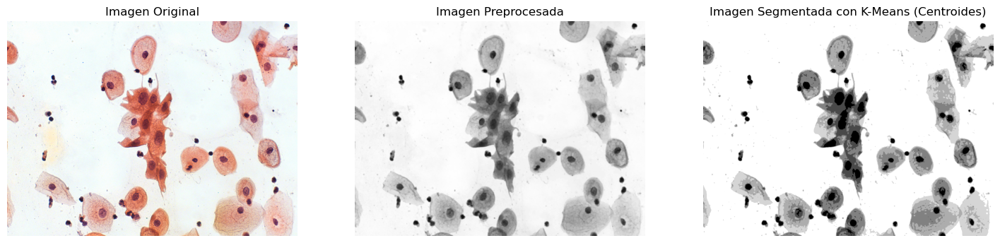

In [10]:
def preprocess_image(image):
    # Convertir la imagen de PIL a array de NumPy
    img_np = np.array(image)
    
    # Convertir la imagen a escala de grises
    gray = cv2.cvtColor(img_np, cv2.COLOR_RGB2GRAY)
    
    # Aplicar un filtro Gaussiano para suavizar la imagen
    blurred = cv2.GaussianBlur(gray, (7, 7), 0)
    
    # Operación morfológica de apertura para eliminar el ruido
    kernel = np.ones((3,3), np.uint8)
    morph_image = cv2.morphologyEx(blurred, cv2.MORPH_OPEN, kernel, iterations=2)
    
    return morph_image

def kmeans_clustering(image, k=3):
    # Reestructurar la imagen a un array 2D de píxeles
    pixel_values = image.reshape((-1, 1))
    pixel_values = np.float32(pixel_values)
    
    # Definir los criterios de K-means (10 iteraciones, precisión de 1.0)
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.2)
    
    # Aplicar K-means
    _, labels, centers = cv2.kmeans(pixel_values, k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
    
    # Convertir los centros de los clusters de nuevo a escala de grises
    centers = np.uint8(centers)
    segmented_image = centers[labels.flatten()]
    
    # Reestructurar la imagen segmentada a las dimensiones originales
    segmented_image = segmented_image.reshape(image.shape)
    
    return segmented_image, labels.reshape(image.shape)

def visualize_side_by_side(original_image, preprocessed_image, segmented_image):
    # Crear una figura con tres subplots, uno para la imagen original, otro para la preprocesada, y otro para la segmentada
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    
    # Mostrar la imagen original
    axes[0].imshow(original_image)
    axes[0].set_title("Imagen Original")
    axes[0].axis('off')
    
    # Mostrar la imagen preprocesada
    axes[1].imshow(preprocessed_image, cmap='gray')
    axes[1].set_title("Imagen Preprocesada")
    axes[1].axis('off')
    
    # Mostrar la imagen segmentada utilizando los valores de los centroides
    axes[2].imshow(segmented_image, cmap='gray')
    axes[2].set_title("Imagen Segmentada con K-Means (Centroides)")
    axes[2].axis('off')
    
    # Mostrar la figura completa
    plt.show()

# Ejemplo de uso con la imagen específica que cargaste
image_name = '00b1e59ebc3e7be500ef7548207d44e2.png'
image_path = 'base/00b1e59ebc3e7be500ef7548207d44e2.png'
img = Image.open(image_path)

# Paso 1: Preprocesar la imagen
preprocessed_image = preprocess_image(img)

# Paso 2: Aplicar clustering con K-Means
segmented_image, labels = kmeans_clustering(preprocessed_image, k=6)

# Visualizar las imágenes lado a lado
visualize_side_by_side(img, preprocessed_image, segmented_image)

Centroides: [122 245  76 158 187 214]
Cluster menos saturado seleccionado: 2


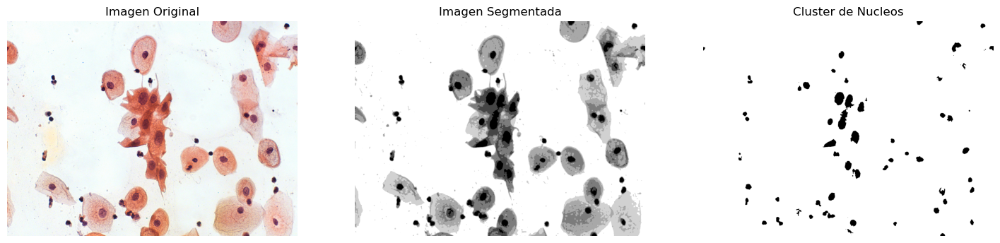

In [11]:
def preprocess_image(image):
    # Convertir la imagen de PIL a array de NumPy
    img_np = np.array(image)
    
    # Convertir la imagen a escala de grises
    gray = cv2.cvtColor(img_np, cv2.COLOR_RGB2GRAY)
    
    # Aplicar un filtro Gaussiano para suavizar la imagen
    blurred = cv2.GaussianBlur(gray, (7, 7), 0)
    
    # Operación morfológica de apertura para eliminar el ruido
    kernel = np.ones((3,3), np.uint8)
    morph_image = cv2.morphologyEx(blurred, cv2.MORPH_OPEN, kernel, iterations=2)
    
    return morph_image

def kmeans_clustering(image, k=6):
    # Reestructurar la imagen a un array 2D de píxeles
    pixel_values = image.reshape((-1, 1))
    pixel_values = np.float32(pixel_values)
    
    # Definir los criterios de K-means (10 iteraciones, precisión de 1.0)
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.2)
    
    # Aplicar K-means
    _, labels, centers = cv2.kmeans(pixel_values, k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
    
    # Convertir los centros de los clusters de nuevo a escala de grises
    centers = np.uint8(centers)
    segmented_image = centers[labels.flatten()]
    
    # Reestructurar la imagen segmentada a las dimensiones originales
    segmented_image = segmented_image.reshape(image.shape)
    
    return segmented_image, labels.reshape(image.shape), centers

def isolate_least_saturated_cluster(segmented_image, labels, centers):
    # Identificar el centroide más bajo (menos saturado)
    least_saturated_cluster = np.argmin(centers)
    
    # Verificación: Imprimir los valores de los centroides y el cluster seleccionado
    print("Centroides:", centers.flatten())
    print("Cluster menos saturado seleccionado:", least_saturated_cluster)
    
    # Crear una máscara binaria donde el cluster seleccionado es blanco (255) y el resto negro (0)
    mask = (labels == least_saturated_cluster).astype(np.uint8) * 255
    
    # Invertir la máscara para que el cluster seleccionado sea negro (0) y lo demás sea blanco (255)
    isolated_image = cv2.bitwise_not(mask)
    
    return isolated_image

def visualize_images(original_image, segmented_image, isolated_image):
    # Crear una figura con tres subplots
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    
    # Mostrar la imagen original
    axes[0].imshow(original_image)
    axes[0].set_title("Imagen Original")
    axes[0].axis('off')
    
    # Mostrar la imagen segmentada
    axes[1].imshow(segmented_image, cmap='gray')
    axes[1].set_title("Imagen Segmentada")
    axes[1].axis('off')
    
    # Mostrar la imagen con el cluster menos saturado en negro
    axes[2].imshow(isolated_image, cmap='gray')
    axes[2].set_title("Cluster de Nucleos")
    axes[2].axis('off')
    
    # Mostrar la figura completa
    plt.show()

# Ejemplo de uso con la imagen específica que cargaste
image_name = '00b1e59ebc3e7be500ef7548207d44e2.png'
image_path = 'base/00b1e59ebc3e7be500ef7548207d44e2.png'
img = Image.open(image_path)

# Paso 1: Preprocesar la imagen
preprocessed_image = preprocess_image(img)

# Paso 2: Aplicar clustering con K-Means
segmented_image, labels, centers = kmeans_clustering(preprocessed_image, k=6)

# Paso 3: Aislar el cluster menos saturado y mostrarlo en negro
isolated_image = isolate_least_saturated_cluster(segmented_image, labels, centers)

# Paso 4: Visualizar las imágenes
visualize_images(img, segmented_image, isolated_image)

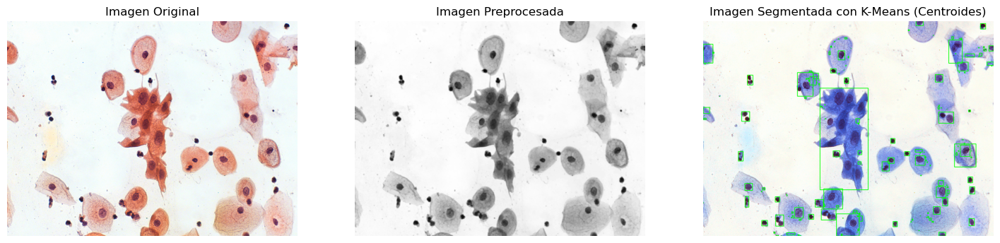

In [12]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image, ImageDraw

def preprocess_image(image):
    # Convertir la imagen de PIL a array de NumPy
    img_np = np.array(image)
    
    # Convertir la imagen a escala de grises
    gray = cv2.cvtColor(img_np, cv2.COLOR_RGB2GRAY)
    
    # Aplicar un filtro Gaussiano para suavizar la imagen
    blurred = cv2.GaussianBlur(gray, (7, 7), 0)
    
    # Operación morfológica de apertura para eliminar el ruido
    kernel = np.ones((3,3), np.uint8)
    morph_image = cv2.morphologyEx(blurred, cv2.MORPH_OPEN, kernel, iterations=2)
    
    return morph_image

# Ejemplo de uso con la imagen específica que cargaste
image_name = '00b1e59ebc3e7be500ef7548207d44e2.png'
image_path = 'base/00b1e59ebc3e7be500ef7548207d44e2.png'
img = Image.open(image_path)

# Paso 1: Preprocesar la imagen
preprocessed_image = preprocess_image(img)

# Aplicar un umbral para obtener una imagen binaria
_, binary = cv2.threshold(preprocessed_image, 150, 255, cv2.THRESH_BINARY_INV)

# Encontrar los contornos
contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Convertir la imagen PIL a formato NumPy y luego BGR para trabajar con OpenCV
img_np = np.array(img)
img_bgr = cv2.cvtColor(img_np, cv2.COLOR_RGB2BGR)

# Dibujar las bounding boxes basadas en los contornos
for contour in contours:
    x, y, w, h = cv2.boundingRect(contour)  # Obtener las coordenadas y dimensiones de la caja
    cv2.rectangle(img_bgr, (x, y), (x + w, y + h), (0, 255, 0), 2)  # Dibujar el rectángulo verde

# Convertir la imagen de OpenCV (BGR) a RGB para mostrar con matplotlib
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

# Visualizar las imágenes lado a lado
visualize_side_by_side(img, preprocessed_image, img_bgr)


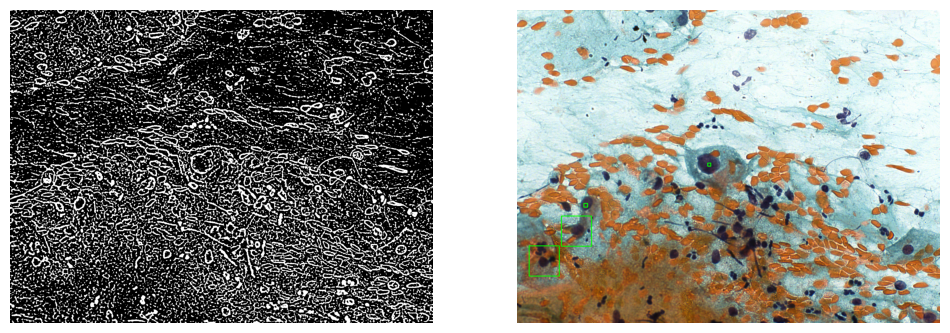

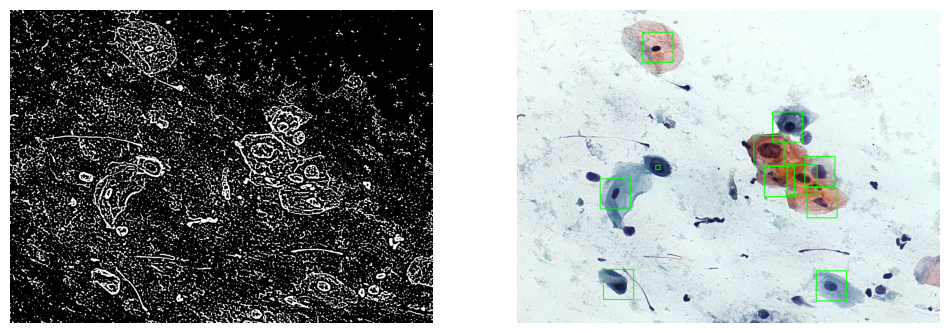

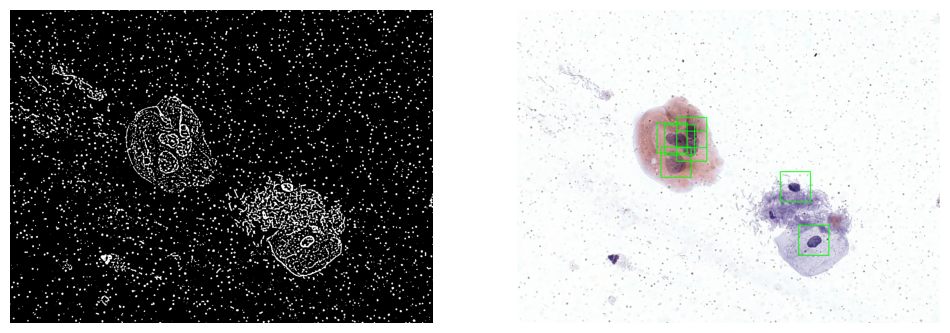

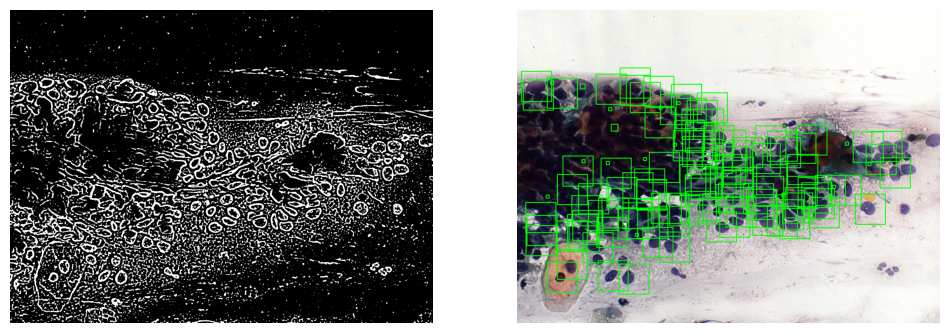

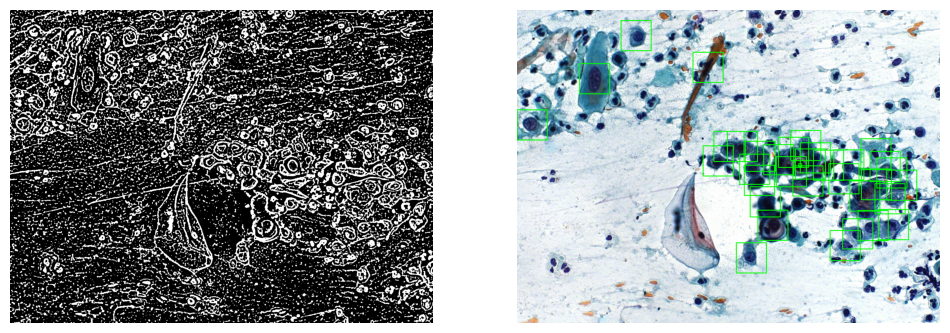

In [6]:
import cv2
import os
import numpy as np
import json
from matplotlib import pyplot as plt
from PIL import Image

def preprocess_image(image):
    # Convertir la imagen de PIL a array de NumPy
    img_np = np.array(image)
    
    # Convertir la imagen a escala de grises
    gray = cv2.cvtColor(img_np, cv2.COLOR_RGB2GRAY)
    
    # Aplicar un filtro Gaussiano para suavizar la imagen
    blurred = cv2.GaussianBlur(gray, (7, 7), 0)
    
    # Operación morfológica de apertura para eliminar el ruido
    kernel = np.ones((3,3), np.uint8)
    morph_image = cv2.morphologyEx(blurred, cv2.MORPH_OPEN, kernel, iterations=2)
    
    return morph_image

def is_nucleus_inside(box, binary_image):
    """ Verifica si los píxeles en los bordes de la caja pertenecen al núcleo (parte blanca en binario). """
    x, y, w, h = box

    # Extraer los píxeles en los bordes de la caja
    top_row = binary_image[y, x:x+w]
    bottom_row = binary_image[y+h, x:x+w]
    left_col = binary_image[y:y+h, x]
    right_col = binary_image[y:y+h, x+w]
    
    # Verificar si alguno de los píxeles del borde pertenece al núcleo
    if (np.any(top_row == 255) or np.any(bottom_row == 255) or
        np.any(left_col == 255) or np.any(right_col == 255)):
        return True  # Sigue expandiendo si el borde toca el núcleo
    else:
        return False  # Detente si el borde no toca el núcleo

def expand_bounding_box(center, binary_image, max_size=100):
    """ Expande la bounding box desde el centro hasta que no encuentre más píxeles del núcleo. """
    cx, cy = center
    step_size = 2  # Incremento para expandir la caja
    size = 10  # Tamaño inicial de la caja
    
    while size < max_size:
        x = max(0, cx - size // 2)
        y = max(0, cy - size // 2)
        w = size
        h = size
        
        box = (x, y, w, h)
        
        # Si el núcleo está dentro de la caja, sigue expandiendo
        if is_nucleus_inside(box, binary_image):
            size += step_size
        else:
            # Si no encuentra más píxeles del núcleo en los bordes, detén la expansión
            break
            
    return box

def visualize_images(preprocessed_image_image, bounding_boxes):
    # Crear una figura con tres subplots
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Mostrar la imagen preprocesada
    axes[0].imshow(preprocessed_image_image, cmap='gray')
    # axes[0].set_title("Imagen Preprocesada")
    axes[0].axis('off')
    
    # Mostrar la imagen con bounding boxes variables
    axes[1].imshow(bounding_boxes, cmap='gray')
    # axes[1].set_title("Bounding Boxes halladas")
    axes[1].axis('off')

    # Mostrar la figura completa
    plt.show()

# Cargar las imágenes desde el directorio
image_directory = "base"
images = []

for filename in os.listdir(image_directory):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        img = Image.open(os.path.join(image_directory, filename))
        images.append((filename, img))

# Cargar los bounding boxes desde el archivo JSON
with open('classificationDownload/classifications.json', 'r') as file:
    bounding_boxes = json.load(file)


# Aplicar la función a las primeras 5 imágenes
for image_name, img in images[:5]:
    # Paso 1: Preprocesar la imagen
    preprocessed_image = preprocess_image(img)
    
    binary = cv2.adaptiveThreshold(preprocessed_image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                               cv2.THRESH_BINARY_INV, 11, 2)
    # Aplicar un umbral para obtener una imagen binaria (núcleo es blanco)
    # _, binary = cv2.threshold(preprocessed_image, 150, 255, cv2.THRESH_BINARY)
    # Convertir la imagen PIL a formato NumPy y luego BGR para trabajar con OpenCV
    img_np = np.array(img)
    img_bgr = cv2.cvtColor(img_np, cv2.COLOR_RGB2BGR)

    # Buscar las clasificaciones correspondientes a la imagen
    for entry in bounding_boxes:
        if entry['image_name'] == image_name:
            classifications = entry['classifications']
            for classification in classifications:
                x_center = classification['nucleus_x']
                y_center = classification['nucleus_y']
                center = (x_center, y_center)
                bounding_box = expand_bounding_box(center, binary)
                if bounding_box is not None:
                    x, y, w, h = bounding_box
                    cv2.rectangle(img_bgr, (x, y), (x + w, y + h), (0, 255, 0), 2)  # Dibujar el rectángulo verde

    # Convertir la imagen de OpenCV (BGR) a RGB para mostrar con matplotlib
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

    visualize_images(binary, img_rgb)
    
    


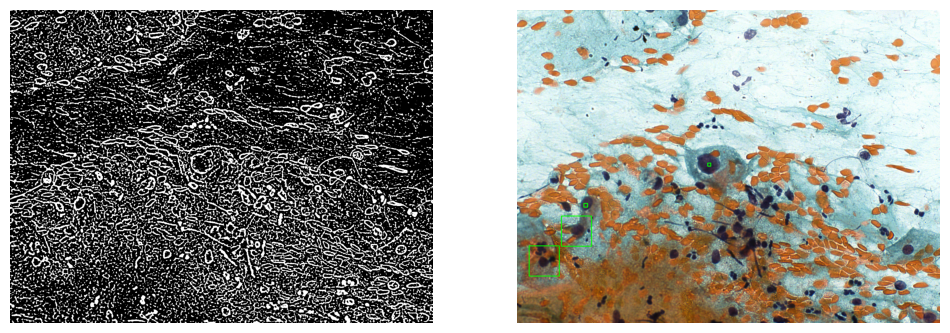

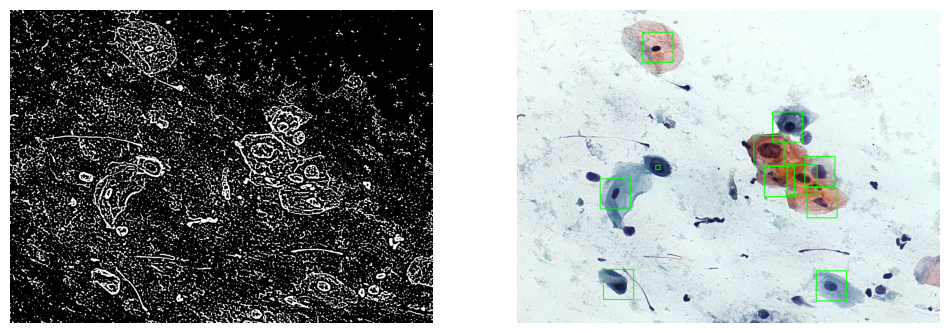

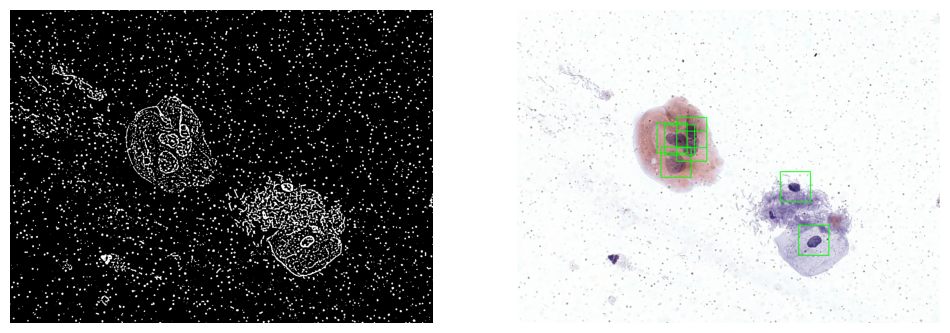

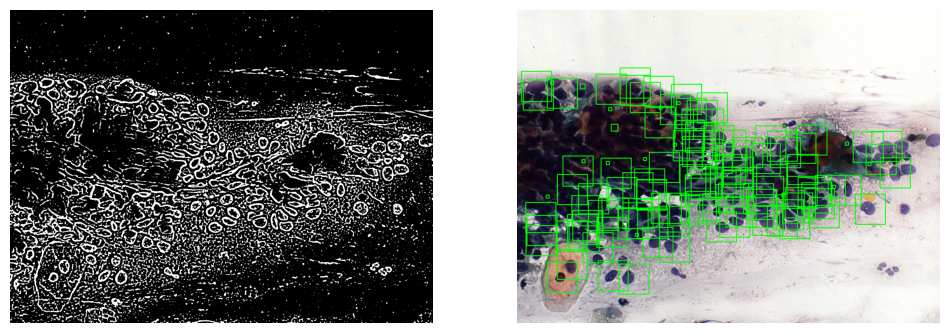

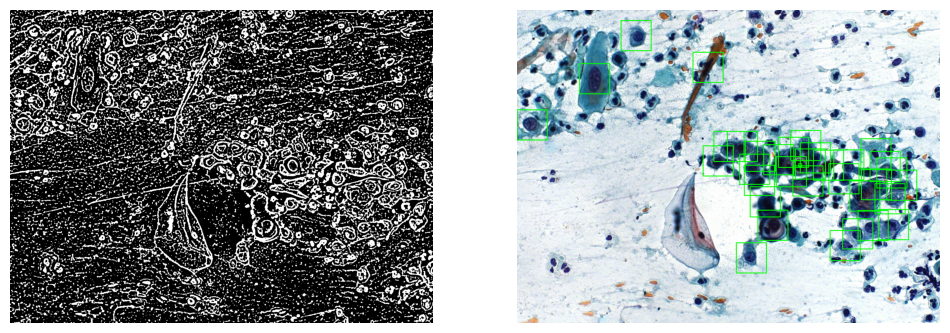

In [4]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image
import os
import json

def preprocess_image(image):
    # Convertir la imagen de PIL a array de NumPy
    img_np = np.array(image)
    
    # Convertir la imagen a escala de grises
    gray = cv2.cvtColor(img_np, cv2.COLOR_RGB2GRAY)
    
    # Aplicar un filtro Gaussiano para suavizar la imagen
    blurred = cv2.GaussianBlur(gray, (7, 7), 0)
    
    # Operación morfológica de apertura para eliminar el ruido
    kernel = np.ones((3, 3), np.uint8)
    morph_image = cv2.morphologyEx(blurred, cv2.MORPH_OPEN, kernel, iterations=2)
    
    return morph_image

def is_nucleus_inside(box, binary_image):
    """ Verifica si los píxeles en los bordes de la caja pertenecen al núcleo (parte blanca en binario). """
    x, y, w, h = box

    # Extraer los píxeles en los bordes de la caja
    top_row = binary_image[y, x:x+w]
    bottom_row = binary_image[y+h, x:x+w]
    left_col = binary_image[y:y+h, x]
    right_col = binary_image[y:y+h, x+w]
    
    # Verificar si alguno de los píxeles del borde pertenece al núcleo
    if (np.any(top_row == 255) or np.any(bottom_row == 255) or
        np.any(left_col == 255) or np.any(right_col == 255)):
        return True  # Sigue expandiendo si el borde toca el núcleo
    else:
        return False  # Detente si el borde no toca el núcleo

def expand_bounding_box(center, binary_image, max_size=100):
    """ Expande la bounding box desde el centro hasta que no encuentre más píxeles del núcleo. """
    cx, cy = center
    step_size = 2  # Incremento para expandir la caja
    size = 10  # Tamaño inicial de la caja
    
    while size < max_size:
        x = max(0, cx - size // 2)
        y = max(0, cy - size // 2)
        w = size
        h = size
        
        box = (x, y, w, h)
        
        # Si el núcleo está dentro de la caja, sigue expandiendo
        if is_nucleus_inside(box, binary_image):
            size += step_size
        else:
            # Si no encuentra más píxeles del núcleo en los bordes, detén la expansión
            break
            
    return box

def visualize_images(preprocessed_image_image, bounding_boxes):
    # Crear una figura con tres subplots
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Mostrar la imagen preprocesada
    axes[0].imshow(preprocessed_image_image, cmap='gray')
    # axes[0].set_title("Imagen Preprocesada")
    axes[0].axis('off')
    
    # Mostrar la imagen con bounding boxes variables
    axes[1].imshow(bounding_boxes, cmap='gray')
    # axes[1].set_title("Bounding Boxes halladas")
    axes[1].axis('off')

    # Mostrar la figura completa
    plt.show()

# Cargar las imágenes desde el directorio
image_directory = "base"  # Ruta de tu directorio de imágenes
images = []

# Verificar si el directorio existe
if os.path.exists(image_directory):
    for filename in os.listdir(image_directory):
        if filename.endswith(".jpg") or filename.endswith(".png"):
            img = Image.open(os.path.join(image_directory, filename))
            images.append((filename, img))
else:
    print(f"El directorio {image_directory} no existe.")

# Cargar los bounding boxes desde el archivo JSON
json_path = 'classificationDownload/classifications.json'  # Ruta de tu archivo JSON
if os.path.exists(json_path):
    with open(json_path, 'r') as file:
        bounding_boxes = json.load(file)
else:
    print(f"El archivo JSON {json_path} no existe.")

# Aplicar la función a las primeras 5 imágenes
for image_name, img in images[:5]:
    # Paso 1: Preprocesar la imagen
    preprocessed_image = preprocess_image(img)
    
    # Paso 2: Aplicar umbral adaptativo para obtener una imagen binaria
    binary = cv2.adaptiveThreshold(preprocessed_image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                                   cv2.THRESH_BINARY_INV, 11, 2)
    
    # Convertir la imagen PIL a formato NumPy y luego BGR para trabajar con OpenCV
    img_np = np.array(img)
    img_bgr = cv2.cvtColor(img_np, cv2.COLOR_RGB2BGR)

    # Paso 3: Buscar las clasificaciones correspondientes a la imagen
    for entry in bounding_boxes:
        if entry['image_name'] == image_name:
            classifications = entry['classifications']
            for classification in classifications:
                x_center = classification['nucleus_x']
                y_center = classification['nucleus_y']
                center = (x_center, y_center)
                
                # Paso 4: Expandir la bounding box
                bounding_box = expand_bounding_box(center, binary)
                if bounding_box is not None:
                    x, y, w, h = bounding_box
                    cv2.rectangle(img_bgr, (x, y), (x + w, y + h), (0, 255, 0), 2)  # Dibujar el rectángulo verde

    # Paso 5: Convertir la imagen de OpenCV (BGR) a RGB para mostrar con matplotlib
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

    visualize_images(binary, img_rgb)


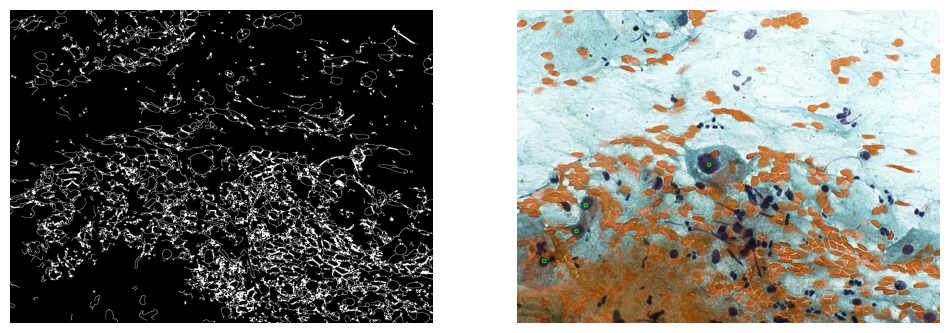

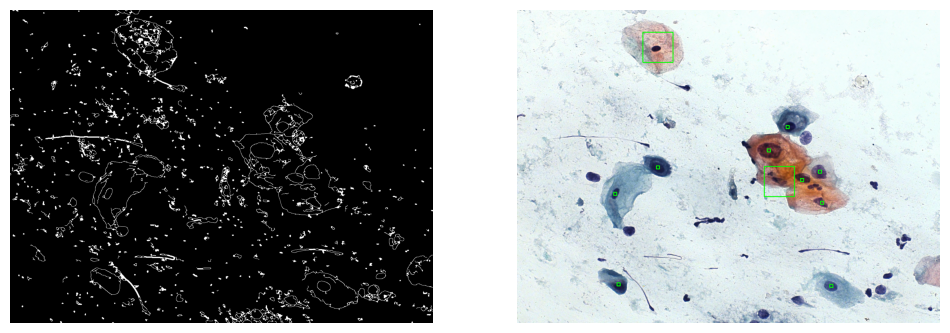

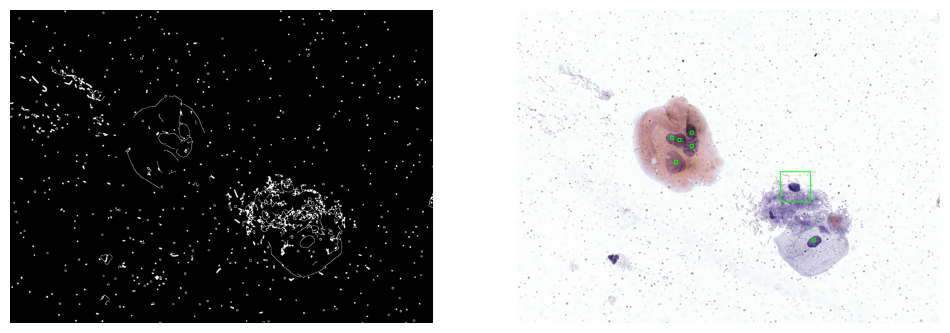

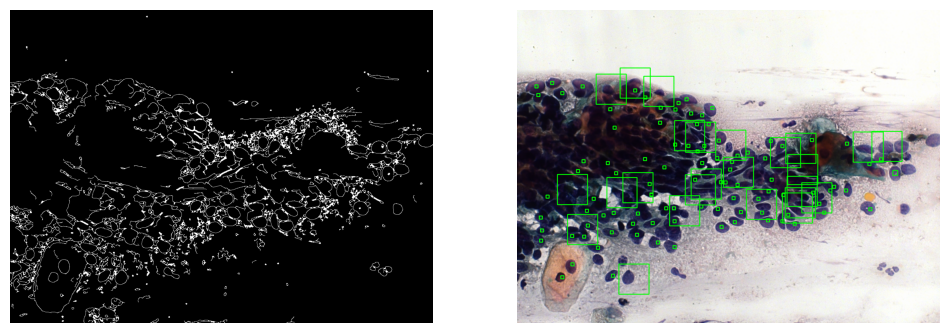

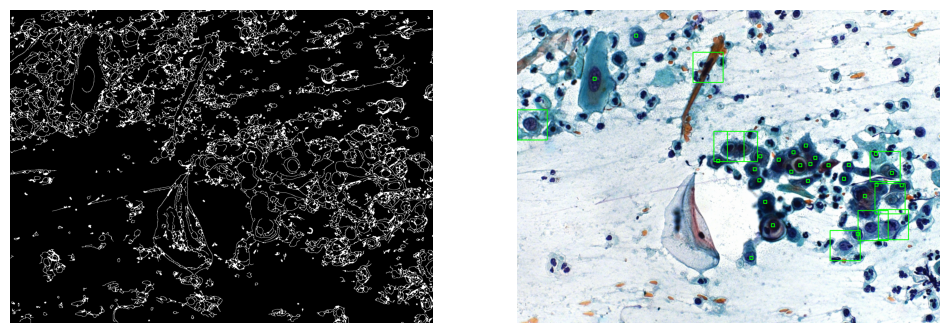

In [3]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image
import os
import json

def preprocess_image(image):
    # Convertir la imagen de PIL a array de NumPy
    img_np = np.array(image)
    
    # Convertir la imagen a escala de grises
    gray = cv2.cvtColor(img_np, cv2.COLOR_RGB2GRAY)
    
    # Aplicar un filtro Gaussiano para suavizar la imagen
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    
    # Aplicar la detección de bordes de Canny para capturar los contornos
    edges = cv2.Canny(blurred, 50, 150)
    
    # Aplicar operaciones morfológicas para cerrar huecos en los bordes detectados
    kernel = np.ones((3, 3), np.uint8)
    closed_edges = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)
    
    return closed_edges

def is_nucleus_inside(box, binary_image):
    """ Verifica si los píxeles en los bordes de la caja pertenecen al núcleo (parte blanca en binario). """
    x, y, w, h = box

    # Extraer los píxeles en los bordes de la caja
    top_row = binary_image[y, x:x+w]
    bottom_row = binary_image[y+h, x:x+w]
    left_col = binary_image[y:y+h, x]
    right_col = binary_image[y:y+h, x+w]
    
    # Verificar si alguno de los píxeles del borde pertenece al núcleo
    if (np.any(top_row == 255) or np.any(bottom_row == 255) or
        np.any(left_col == 255) or np.any(right_col == 255)):
        return True  # Sigue expandiendo si el borde toca el núcleo
    else:
        return False  # Detente si el borde no toca el núcleo

def expand_bounding_box(center, binary_image, max_size=100):
    """ Expande la bounding box desde el centro hasta que no encuentre más píxeles del núcleo. """
    cx, cy = center
    step_size = 2  # Incremento para expandir la caja
    size = 10  # Tamaño inicial de la caja
    
    while size < max_size:
        x = max(0, cx - size // 2)
        y = max(0, cy - size // 2)
        w = size
        h = size
        
        box = (x, y, w, h)
        
        # Si el núcleo está dentro de la caja, sigue expandiendo
        if is_nucleus_inside(box, binary_image):
            size += step_size
        else:
            # Si no encuentra más píxeles del núcleo en los bordes, detén la expansión
            break
            
    return box

def visualize_images(preprocessed_image_image, bounding_boxes):
    # Crear una figura con tres subplots
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Mostrar la imagen preprocesada
    axes[0].imshow(preprocessed_image_image, cmap='gray')
    # axes[0].set_title("Imagen Preprocesada")
    axes[0].axis('off')
    
    # Mostrar la imagen con bounding boxes variables
    axes[1].imshow(bounding_boxes, cmap='gray')
    # axes[1].set_title("Bounding Boxes halladas")
    axes[1].axis('off')

    # Mostrar la figura completa
    plt.show()

# Cargar las imágenes desde el directorio
image_directory = "base"  # Ruta de tu directorio de imágenes
images = []

# Verificar si el directorio existe
if os.path.exists(image_directory):
    for filename in os.listdir(image_directory):
        if filename.endswith(".jpg") or filename.endswith(".png"):
            img = Image.open(os.path.join(image_directory, filename))
            images.append((filename, img))
else:
    print(f"El directorio {image_directory} no existe.")

# Cargar los bounding boxes desde el archivo JSON
json_path = 'classificationDownload/classifications.json'  # Ruta de tu archivo JSON
if os.path.exists(json_path):
    with open(json_path, 'r') as file:
        bounding_boxes = json.load(file)
else:
    print(f"El archivo JSON {json_path} no existe.")

# Aplicar la función a las primeras 5 imágenes
for image_name, img in images[:5]:
    # Paso 1: Preprocesar la imagen
    preprocessed_image = preprocess_image(img)
    
    # Paso 2: Aplicar umbral adaptativo para obtener una imagen binaria
    _, binary = cv2.threshold(preprocessed_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    
    # Convertir la imagen PIL a formato NumPy y luego BGR para trabajar con OpenCV
    img_np = np.array(img)
    img_bgr = cv2.cvtColor(img_np, cv2.COLOR_RGB2BGR)

    # Paso 3: Buscar las clasificaciones correspondientes a la imagen
    for entry in bounding_boxes:
        if entry['image_name'] == image_name:
            classifications = entry['classifications']
            for classification in classifications:
                x_center = classification['nucleus_x']
                y_center = classification['nucleus_y']
                center = (x_center, y_center)
                
                # Paso 4: Expandir la bounding box
                bounding_box = expand_bounding_box(center, binary)
                if bounding_box is not None:
                    x, y, w, h = bounding_box
                    cv2.rectangle(img_bgr, (x, y), (x + w, y + h), (0, 255, 0), 2)  # Dibujar el rectángulo verde

    # Paso 5: Convertir la imagen de OpenCV (BGR) a RGB para mostrar con matplotlib
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

    visualize_images(binary, img_rgb)



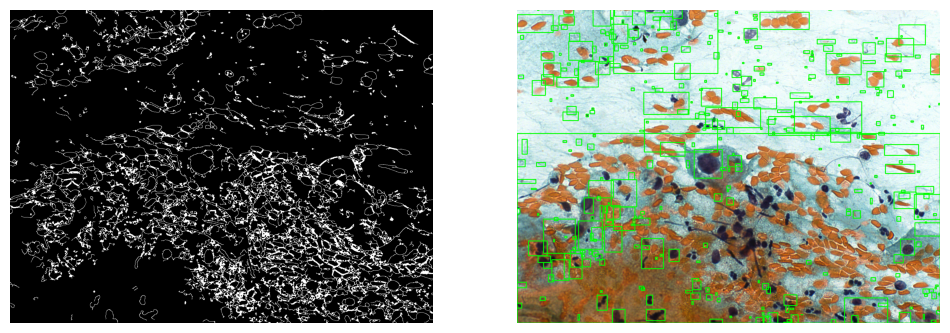

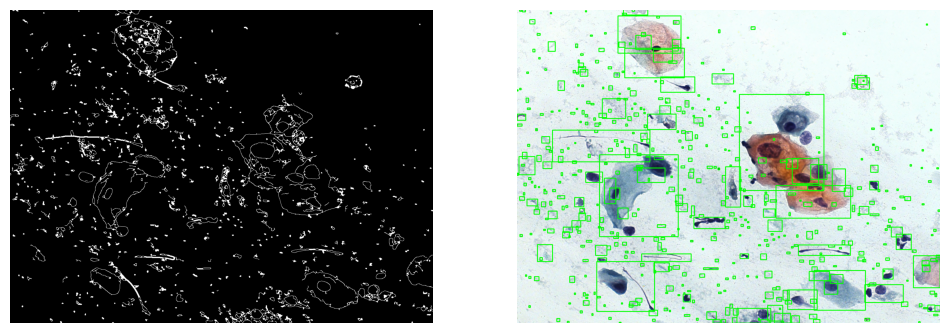

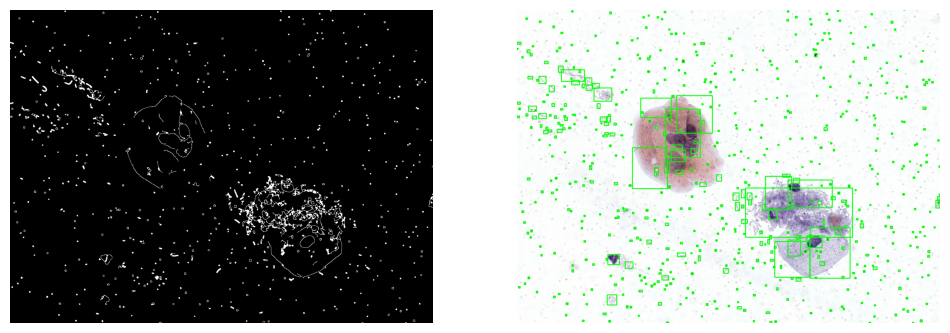

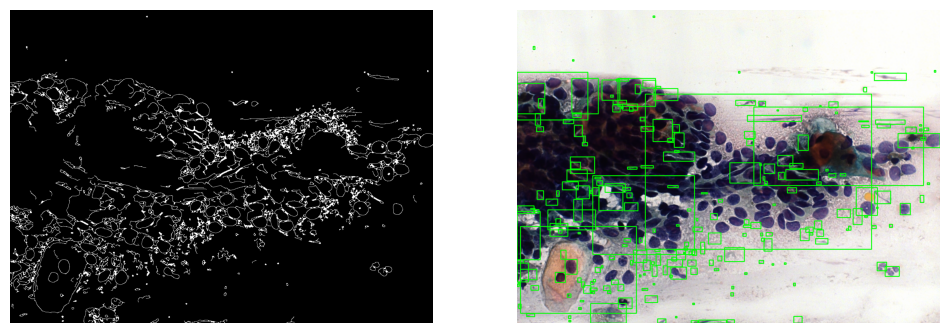

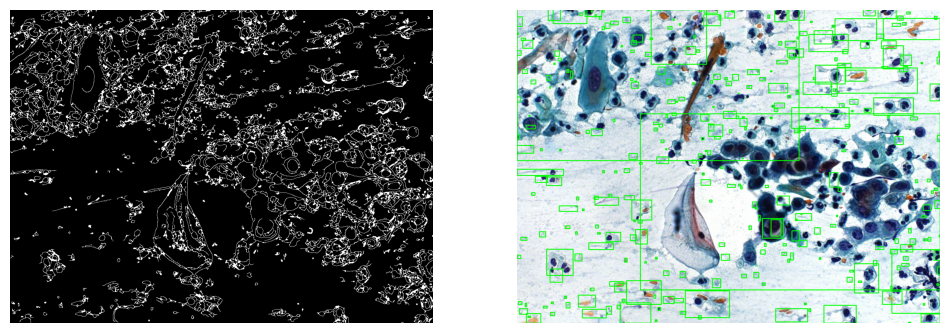

In [2]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image
import os
import json

def preprocess_image(image):
    # Convertir la imagen de PIL a array de NumPy
    img_np = np.array(image)
    
    # Convertir la imagen a escala de grises
    gray = cv2.cvtColor(img_np, cv2.COLOR_RGB2GRAY)
    
    # Aplicar un filtro Gaussiano para suavizar la imagen
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    
    # Aplicar la detección de bordes de Canny para capturar los contornos
    edges = cv2.Canny(blurred, 50, 150)
    
    # Aplicar operaciones morfológicas para cerrar huecos en los bordes detectados
    kernel = np.ones((3, 3), np.uint8)
    closed_edges = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)
    
    return closed_edges

def find_nucleus_contours(binary_image):
    """ Detectar los contornos en la imagen binaria """
    contours, _ = cv2.findContours(binary_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    return contours

def visualize_images(preprocessed_image_image, bounding_boxes):
    # Crear una figura con tres subplots
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Mostrar la imagen preprocesada
    axes[0].imshow(preprocessed_image_image, cmap='gray')
    # axes[0].set_title("Imagen Preprocesada")
    axes[0].axis('off')
    
    # Mostrar la imagen con bounding boxes variables
    axes[1].imshow(bounding_boxes, cmap='gray')
    # axes[1].set_title("Bounding Boxes halladas")
    axes[1].axis('off')

    # Mostrar la figura completa
    plt.show()

# Cargar las imágenes desde el directorio
image_directory = "base"  # Ruta de tu directorio de imágenes
images = []

# Verificar si el directorio existe
if os.path.exists(image_directory):
    for filename in os.listdir(image_directory):
        if filename.endswith(".jpg") or filename.endswith(".png"):
            img = Image.open(os.path.join(image_directory, filename))
            images.append((filename, img))
else:
    print(f"El directorio {image_directory} no existe.")

# Cargar los bounding boxes desde el archivo JSON
json_path = 'classificationDownload/classifications.json'  # Ruta de tu archivo JSON
if os.path.exists(json_path):
    with open(json_path, 'r') as file:
        bounding_boxes = json.load(file)
else:
    print(f"El archivo JSON {json_path} no existe.")

# Aplicar la función a las primeras 5 imágenes
for image_name, img in images[:5]:
    # Paso 1: Preprocesar la imagen
    preprocessed_image = preprocess_image(img)
    
    # Paso 2: Aplicar umbral binario (Otsu) para obtener una imagen binaria
    _, binary = cv2.threshold(preprocessed_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    
    # Convertir la imagen PIL a formato NumPy y luego BGR para trabajar con OpenCV
    img_np = np.array(img)
    img_bgr = cv2.cvtColor(img_np, cv2.COLOR_RGB2BGR)

    # Paso 3: Detectar contornos
    contours = find_nucleus_contours(binary)

    # Paso 4: Dibujar las bounding boxes alrededor de los contornos
    for contour in contours:
        x, y, w, h = cv2.boundingRect(contour)
        cv2.rectangle(img_bgr, (x, y), (x + w, y + h), (0, 255, 0), 2)  # Dibujar el rectángulo verde

    # Paso 5: Convertir la imagen de OpenCV (BGR) a RGB para mostrar con matplotlib
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

    visualize_images(binary, img_rgb)


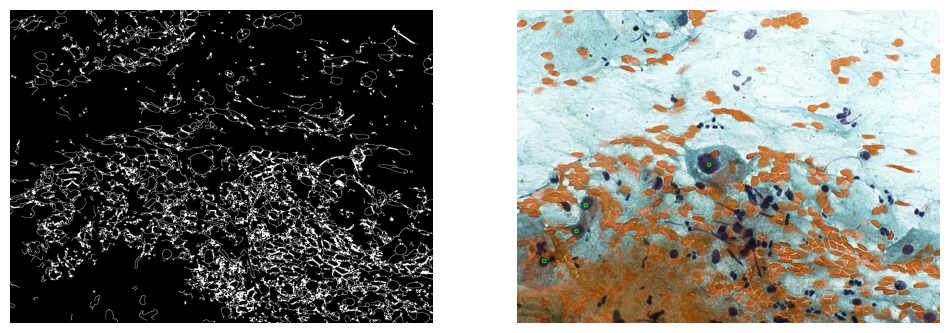

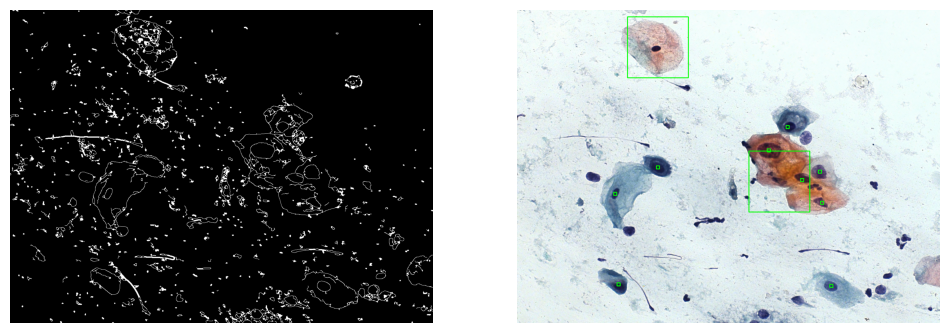

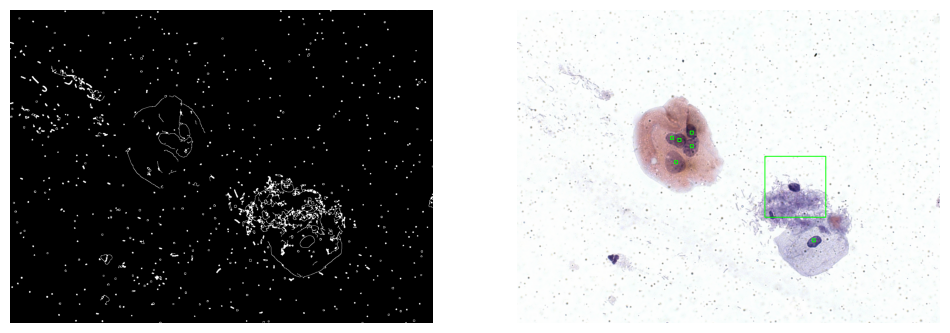

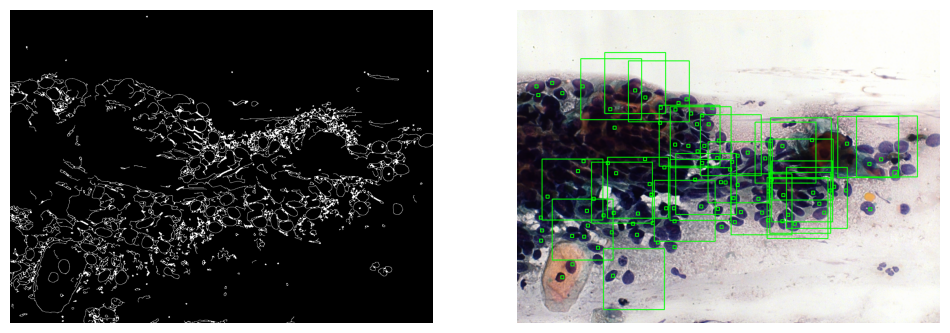

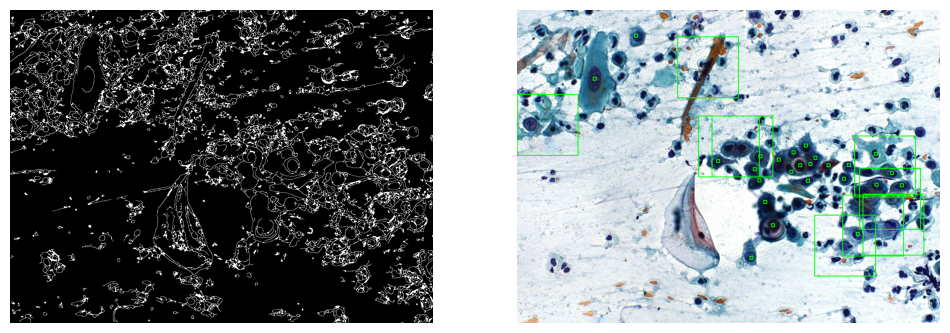

In [1]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image
import os
import json

def preprocess_image(image):
    # Convertir la imagen de PIL a array de NumPy
    img_np = np.array(image)
    
    # Convertir la imagen a escala de grises
    gray = cv2.cvtColor(img_np, cv2.COLOR_RGB2GRAY)
    
    # Aplicar un filtro Gaussiano para suavizar la imagen
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    
    # Aplicar la detección de bordes de Canny para capturar los contornos
    edges = cv2.Canny(blurred, 50, 150)
    
    # Aplicar operaciones morfológicas para cerrar huecos en los bordes detectados
    kernel = np.ones((3, 3), np.uint8)
    closed_edges = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)
    
    return closed_edges

def is_nucleus_inside(box, binary_image):
    """ Verifica si los píxeles en los bordes de la caja pertenecen al núcleo (parte blanca en binario). """
    x, y, w, h = box

    # Extraer los píxeles en los bordes de la caja
    top_row = binary_image[y, x:x+w]
    bottom_row = binary_image[y+h, x:x+w]
    left_col = binary_image[y:y+h, x]
    right_col = binary_image[y:y+h, x+w]
    
    # Verificar si alguno de los píxeles del borde pertenece al núcleo
    if (np.any(top_row == 255) or np.any(bottom_row == 255) or
        np.any(left_col == 255) or np.any(right_col == 255)):
        return True  # Sigue expandiendo si el borde toca el núcleo
    else:
        return False  # Detente si el borde no toca el núcleo

def expand_bounding_box(center, binary_image, max_size=200):
    """ Expande la bounding box desde el centro hasta que no encuentre más píxeles del núcleo. """
    cx, cy = center
    step_size = 2  # Incremento para expandir la caja
    size = 10  # Tamaño inicial de la caja
    
    while size < max_size:
        x = max(0, cx - size // 2)
        y = max(0, cy - size // 2)
        w = size
        h = size
        
        box = (x, y, w, h)
        
        # Si el núcleo está dentro de la caja, sigue expandiendo
        if is_nucleus_inside(box, binary_image):
            size += step_size
        else:
            # Si no encuentra más píxeles del núcleo en los bordes, detén la expansión
            break
            
    return box

def visualize_images(preprocessed_image_image, bounding_boxes):
    # Crear una figura con tres subplots
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Mostrar la imagen preprocesada
    axes[0].imshow(preprocessed_image_image, cmap='gray')
    # axes[0].set_title("Imagen Preprocesada")
    axes[0].axis('off')
    
    # Mostrar la imagen con bounding boxes variables
    axes[1].imshow(bounding_boxes, cmap='gray')
    # axes[1].set_title("Bounding Boxes halladas")
    axes[1].axis('off')

    # Mostrar la figura completa
    plt.show()

# Cargar las imágenes desde el directorio
image_directory = "base"  # Ruta de tu directorio de imágenes
images = []

# Verificar si el directorio existe
if os.path.exists(image_directory):
    for filename in os.listdir(image_directory):
        if filename.endswith(".jpg") or filename.endswith(".png"):
            img = Image.open(os.path.join(image_directory, filename))
            images.append((filename, img))
else:
    print(f"El directorio {image_directory} no existe.")

# Cargar los bounding boxes desde el archivo JSON
json_path = 'classificationDownload/classifications.json'  # Ruta de tu archivo JSON
if os.path.exists(json_path):
    with open(json_path, 'r') as file:
        bounding_boxes = json.load(file)
else:
    print(f"El archivo JSON {json_path} no existe.")

# Aplicar la función a las primeras 5 imágenes
for image_name, img in images[:5]:
    # Paso 1: Preprocesar la imagen
    preprocessed_image = preprocess_image(img)
    
    # Paso 2: Aplicar umbral adaptativo para obtener una imagen binaria
    _, binary = cv2.threshold(preprocessed_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    
    # Convertir la imagen PIL a formato NumPy y luego BGR para trabajar con OpenCV
    img_np = np.array(img)
    img_bgr = cv2.cvtColor(img_np, cv2.COLOR_RGB2BGR)

    # Paso 3: Buscar las clasificaciones correspondientes a la imagen
    for entry in bounding_boxes:
        if entry['image_name'] == image_name:
            classifications = entry['classifications']
            for classification in classifications:
                x_center = classification['nucleus_x']
                y_center = classification['nucleus_y']
                center = (x_center, y_center)
                
                # Paso 4: Expandir la bounding box
                bounding_box = expand_bounding_box(center, binary)
                if bounding_box is not None:
                    x, y, w, h = bounding_box
                    cv2.rectangle(img_bgr, (x, y), (x + w, y + h), (0, 255, 0), 2)  # Dibujar el rectángulo verde

    # Paso 5: Convertir la imagen de OpenCV (BGR) a RGB para mostrar con matplotlib
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

    visualize_images(binary, img_rgb)

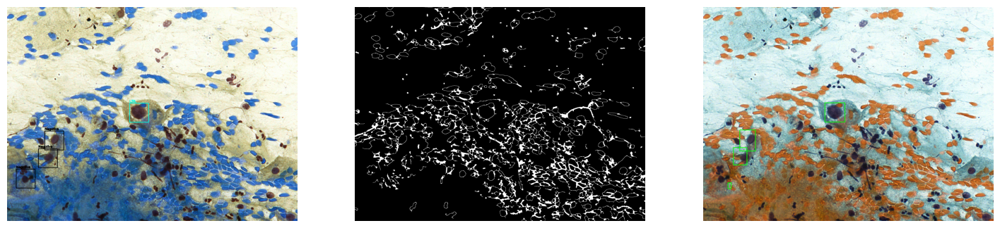

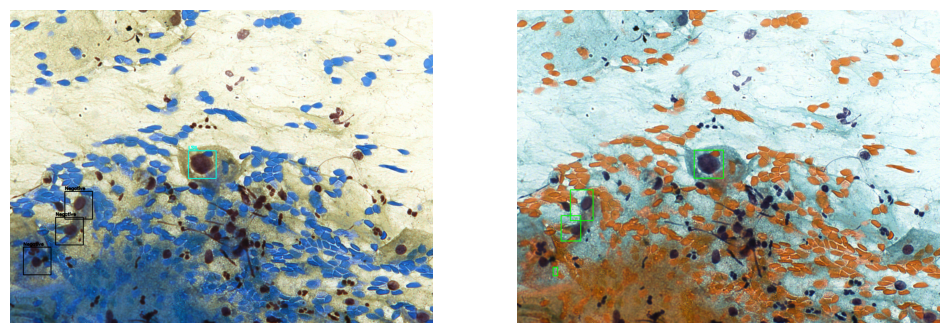

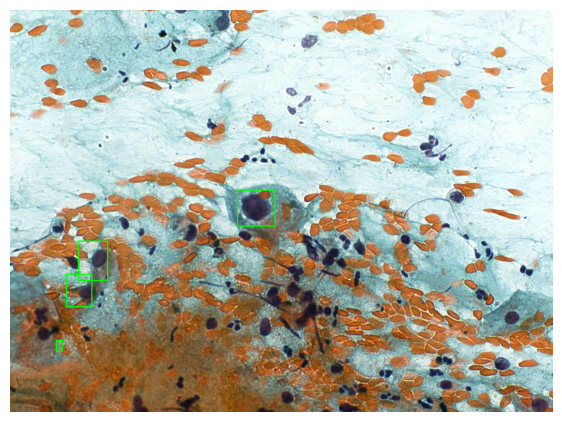

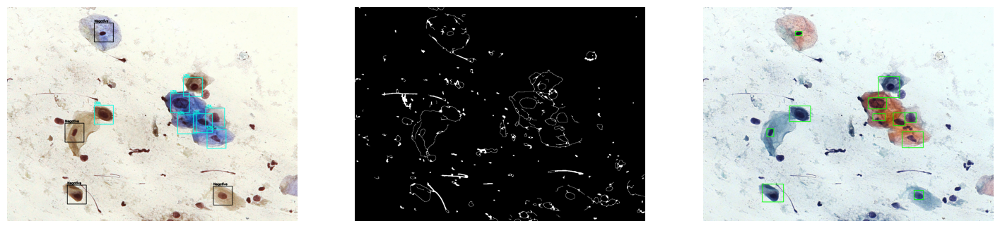

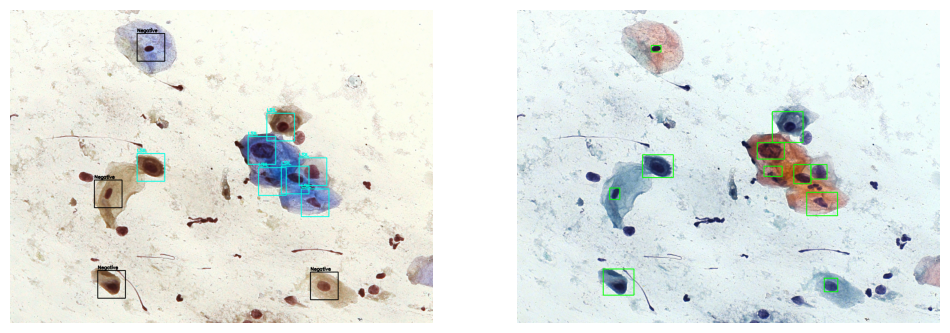

...

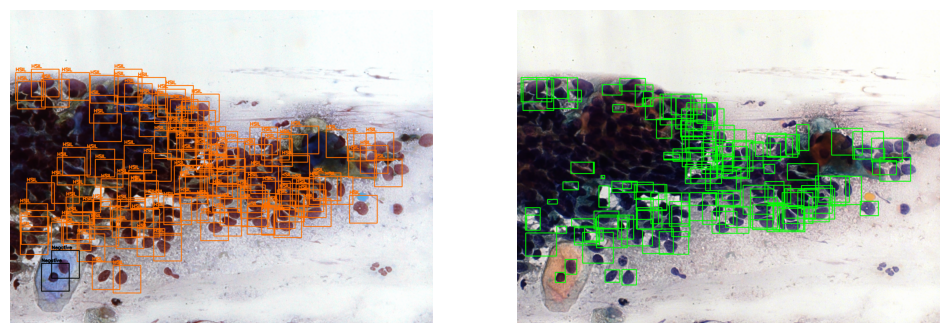

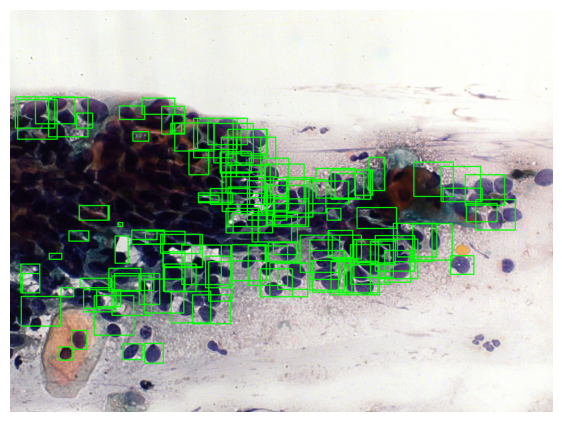

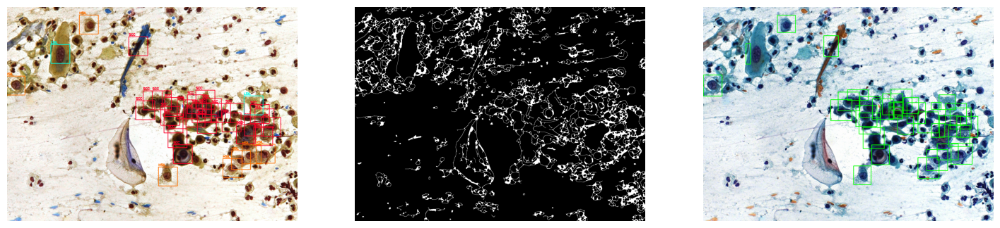

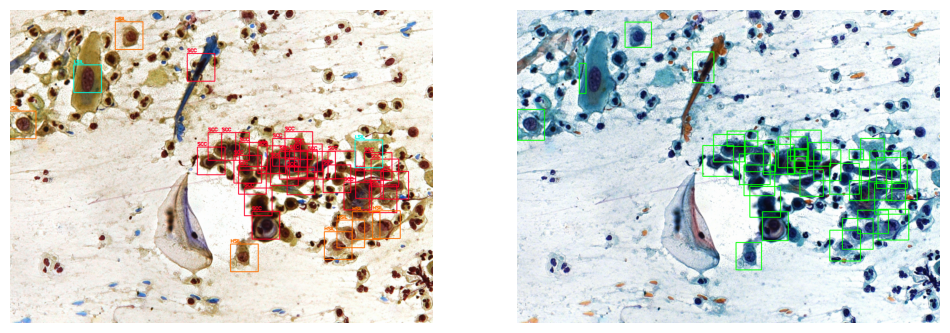

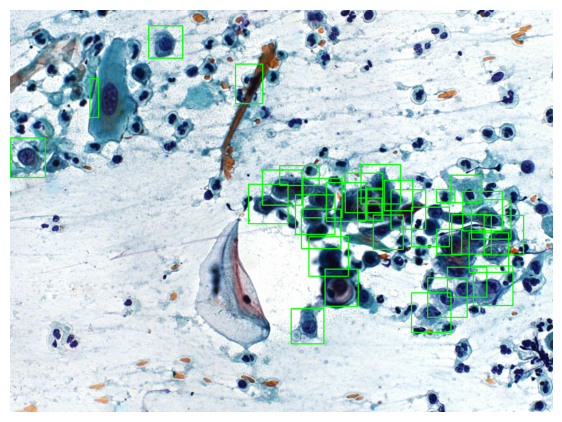

In [10]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image
import os
import json

def preprocess_image(image):
    # # Convertir la imagen de PIL a array de NumPy
    # img_np = np.array(image)
    
    # # Convertir la imagen a escala de grises
    # gray = cv2.cvtColor(img_np, cv2.COLOR_RGB2GRAY)
    
    # # Aplicar un filtro Gaussiano para suavizar la imagen
    # blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    
    # # Aplicar la detección de bordes de Canny para capturar los contornos
    # edges = cv2.Canny(blurred, 50, 150)
    
    # # Aplicar operaciones morfológicas para cerrar huecos en los bordes detectados
    # kernel = np.ones((3, 3), np.uint8)
    # closed_edges = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)
    
    # return closed_edges
    # Convertir la imagen de PIL a array de NumPy
    img_np = np.array(image)
    
    # Convertir la imagen a escala de grises
    gray = cv2.cvtColor(img_np, cv2.COLOR_RGB2GRAY)
    
    # Aplicar un filtro Gaussiano para suavizar la imagen (suaviza los bordes)
    blurred = cv2.GaussianBlur(gray, (7, 7), 0)
    
    # Aplicar la detección de bordes de Canny para obtener contornos
    edges = cv2.Canny(blurred, 50, 150)
    
    # Aplicar operaciones morfológicas para limpiar el ruido y cerrar pequeños huecos
    kernel = np.ones((5, 5), np.uint8)
    morphed_edges = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)
    
    return morphed_edges

# def find_nucleus_contours(binary_image):
#     """ Detectar los contornos en la imagen binaria """
#     contours, _ = cv2.findContours(binary_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
#     return contours

def detect_largest_bounding_box_from_center(binary_image, center, search_radius=50):
    """ Detecta el contorno más grande alrededor de un centro dado y crea una única bounding box ajustada a este.
    
    Args:
        binary_image (numpy.ndarray): Imagen binaria donde los objetos (núcleos) son blancos (255) y el fondo es negro (0).
        center (tuple): Coordenadas del centro (x, y) alrededor del cual se busca el contorno.
        search_radius (int): Radio de búsqueda alrededor del centro para detectar el contorno.
        
    Returns:
        bounding_box (tuple): Coordenadas y tamaño de la bounding box en formato (x, y, w, h), o None si no se encuentra.
    """
    cx, cy = center
    h, w = binary_image.shape

    # Definir los límites de la región alrededor del centro
    x_start = max(0, cx - search_radius)
    x_end = min(w, cx + search_radius)
    y_start = max(0, cy - search_radius)
    y_end = min(h, cy + search_radius)
    
    # Extraer la región de interés (ROI) de la imagen binaria
    roi = binary_image[y_start:y_end, x_start:x_end]
    
    # Detectar los contornos dentro de la región de interés
    contours, _ = cv2.findContours(roi, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    if len(contours) == 0:
        return None  # Si no se detectan contornos, devolvemos None
    
    # Seleccionar el contorno más grande basado en el área
    largest_contour = max(contours, key=cv2.contourArea)
    
    # Obtener la bounding box ajustada al contorno más grande
    x, y, w, h = cv2.boundingRect(largest_contour)
    
    # Ajustar las coordenadas de la ROI a la imagen original
    x += x_start
    y += y_start

    return (x, y, w, h)

# Diccionario de colores para clases en formato BGR
class_colors = {
    'SCC': (252, 0, 38),  # Rojo
    'ASC-US': (15, 252, 0),  # Verde
    'LSIL': (0, 252, 229),  # Celeste
    'HSIL': (252, 111, 0),  # Naranja
    'ASC-H': (237, 0, 252),  # Rosa
    'Negative for intraepithelial lesion': (0, 15, 252),  # Azul Oscuro
}

# Función para ajustar el nombre de la clase "Negative for intraepithelial lesion" a "Negative"
def adjust_class_name(bethesda_system):
    if bethesda_system == 'Negative for intraepithelial lesion':
        return 'Negative'
    return bethesda_system

def detect_fixed_bounding_boxes(img_bgr, classifications, save_path='output_image.png'):
    rect_width, rect_height = 90, 90  # Tamaño fijo del bounding box (90x90 píxeles)

    for classification in classifications:
        x_center = classification['nucleus_x']
        y_center = classification['nucleus_y']
        bethesda_system = adjust_class_name(classification['bethesda_system'])  # Ajustar nombre de clase
        
        # Calcular la esquina superior izquierda del bounding box
        x = int(x_center - rect_width / 2)
        y = int(y_center - rect_height / 2)
        
        # Obtener el color para la clase bethesda_system
        color = class_colors.get(bethesda_system, (0, 0, 0))  # Usa negro si la clase no tiene color asignado
        
        # Asegurarse de que el color es una tupla de longitud 3
        if len(color) != 3:
            raise ValueError(f"Color for class '{bethesda_system}' must be a BGR tuple of length 3, got {color}.")
        
        # Dibujar el bounding box en la imagen (en formato BGR)
        cv2.rectangle(img_bgr, (x, y), (x + rect_width, y + rect_height), color, 2)
        
        # Etiquetar el bounding box solo con la clase
        label = bethesda_system  # Solo mostrar la clase
        cv2.putText(img_bgr, label, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    # Guardar la imagen con bounding boxes
    cv2.imwrite(save_path, img_bgr)  # Guarda la imagen en formato BGR
    
    return img_bgr  # Devuelve la imagen modificada para uso posterior

def visualize_images(fixed_bounding_boxes,preprocessed_image_image, bounding_boxes):
    # Crear una figura con tres subplots
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    
    # Mostrar la imagen original
    axes[0].imshow(fixed_bounding_boxes)
    # axes[0].set_title("Imagen Preprocesada")
    axes[0].axis('off')


    # Mostrar la imagen preprocesada
    axes[1].imshow(preprocessed_image_image, cmap='gray')
    # axes[0].set_title("Imagen Preprocesada")
    axes[1].axis('off')
    
    # Mostrar la imagen con bounding boxes variables
    axes[2].imshow(bounding_boxes, cmap='gray')
    # axes[1].set_title("Bounding Boxes halladas")
    axes[2].axis('off')

    # Mostrar la figura completa
    plt.show()

def visualize_images_2(fixed_bounding_boxes, bounding_boxes):
    # Crear una figura con tres subplots
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    
    # Mostrar la imagen original
    axes[0].imshow(fixed_bounding_boxes)
    # axes[0].set_title("Imagen Preprocesada")
    axes[0].axis('off')

    # Mostrar la imagen con bounding boxes variables
    axes[1].imshow(bounding_boxes, cmap='gray')
    # axes[1].set_title("Bounding Boxes halladas")
    axes[1].axis('off')

    # Mostrar la figura completa
    plt.show()

# Cargar las imágenes desde el directorio
image_directory = "base"  # Ruta de tu directorio de imágenes
images = []

# Verificar si el directorio existe
if os.path.exists(image_directory):
    for filename in os.listdir(image_directory):
        if filename.endswith(".jpg") or filename.endswith(".png"):
            img = Image.open(os.path.join(image_directory, filename))
            images.append((filename, img))
else:
    print(f"El directorio {image_directory} no existe.")

# Cargar los bounding boxes desde el archivo JSON
json_path = 'classificationDownload/classifications.json'  # Ruta de tu archivo JSON
if os.path.exists(json_path):
    with open(json_path, 'r') as file:
        bounding_boxes = json.load(file)
else:
    print(f"El archivo JSON {json_path} no existe.")

# Aplicar la función a las primeras 5 imágenes
for image_name, img in images[:5]:
    # Paso 1: Preprocesar la imagen
    preprocessed_image = preprocess_image(img)
    
    # Paso 2: Aplicar umbral binario (Otsu) para obtener una imagen binaria
    _, binary = cv2.threshold(preprocessed_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    
    # Convertir la imagen PIL a formato NumPy y luego BGR para trabajar con OpenCV
    img_np = np.array(img)
    img_bgr = cv2.cvtColor(img_np, cv2.COLOR_RGB2BGR)

    # Crear una copia de img_bgr para las bounding boxes fijas
    img_bgr_fixed = img_bgr.copy()

    # Paso 3: Detectar contornos
    for entry in bounding_boxes:
        if entry['image_name'] == image_name:
            classifications = entry['classifications']
            for classification in classifications:
                x_center = classification['nucleus_x']
                y_center = classification['nucleus_y']
                center = (x_center, y_center)
                
                # Paso 4: Expandir la bounding box
                bounding_box = detect_largest_bounding_box_from_center(binary, center)
                if bounding_box is not None:
                    x, y, w, h = bounding_box
                    cv2.rectangle(img_bgr, (x, y), (x + w, y + h), (0, 255, 0), 2)  # Dibujar el rectángulo verde

    # Paso 5: Convertir la imagen de OpenCV (BGR) a RGB para mostrar con matplotlib
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

    # Detectar y dibujar bounding boxes fijas en la copia
    for entry in bounding_boxes:
        if entry['image_name'] == image_name:
            classifications = entry['classifications']
            fixed_bounding_boxes = detect_fixed_bounding_boxes(img_bgr_fixed, classifications)  # Usa la copia para las boxes fijas
        
    visualize_images(fixed_bounding_boxes, binary, img_rgb)
    visualize_images_2(fixed_bounding_boxes, img_rgb)

    plt.figure(figsize=(7, 7))
    plt.imshow(img_rgb)
    plt.axis('off')
    plt.show()



In [14]:
import cv2
import numpy as np
import os
import json
from matplotlib import pyplot as plt
from PIL import Image

def preprocess_image(image):
    # Convertir la imagen de PIL a array de NumPy
    img_np = np.array(image)
    
    # Convertir la imagen a escala de grises
    gray = cv2.cvtColor(img_np, cv2.COLOR_RGB2GRAY)
    
    # Aplicar un filtro Gaussiano para suavizar la imagen
    blurred = cv2.GaussianBlur(gray, (7, 7), 0)
    
    # Operación morfológica de apertura para eliminar el ruido
    kernel = np.ones((3,3), np.uint8)
    morph_image = cv2.morphologyEx(blurred, cv2.MORPH_OPEN, kernel, iterations=2)
    
    return morph_image

def kmeans_clustering(image, k=3):
    # Reestructurar la imagen a un array 2D de píxeles
    pixel_values = image.reshape((-1, 1))
    pixel_values = np.float32(pixel_values)
    
    # Definir los criterios de K-means (10 iteraciones, precisión de 1.0)
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.2)
    
    # Aplicar K-means
    _, labels, centers = cv2.kmeans(pixel_values, k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
    
    # Convertir los centros de los clusters de nuevo a escala de grises
    centers = np.uint8(centers)
    segmented_image = centers[labels.flatten()]
    
    # Reestructurar la imagen segmentada a las dimensiones originales
    segmented_image = segmented_image.reshape(image.shape)
    
    return segmented_image, labels.reshape(image.shape), centers

def expand_bounding_box_from_center(center, segmented_image, max_size=200):
    """ Expande la bounding box desde el centro hasta que no encuentre más píxeles del núcleo. """
    cx, cy = center
    color_bgr = segmented_image[center]
    size = 10  # Tamaño inicial de la caja (mínimo)
    height, width = edges.shape  # Obtener dimensiones de la imagen
    
    while size < max_size:
        x = max(0, cx - size // 2)
        y = max(0, cy - size // 2)
        w = min(size, width - x)  # Asegurar que no se pase del borde derecho
        h = min(size, height - y)  # Asegurar que no se pase del borde inferior
        
        # Extraer los píxeles en los bordes de la caja
        top_row = edges[y, x:x+w]
        bottom_row = edges[y+h-1, x:x+w]  # Ajustar h para no exceder los límites
        left_col = edges[y:y+h, x]
        right_col = edges[y:y+h, x+w-1]  # Ajustar w para no exceder los límites
        
        # Si en alguno de los bordes hay píxeles negros (borde del núcleo), se continúa expandiendo
        if (np.any(top_row == color_bgr) or np.any(bottom_row == color_bgr) or
            np.any(left_col == color_bgr) or np.any(right_col == color_bgr)):
            size += 5  # Incrementar la caja si aún toca el núcleo
        else:
            break  # Detener la expansión si los bordes son del fondo
    
    return (x, y, w, h)


def visualize(original_image, segmented_image, bounding_boxes):
    # Crear una figura con tres subplots
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    

    # Mostrar la imagen original
    axes[0].imshow(original_image)
    axes[0].set_title("Imagen Original")
    axes[0].axis('off')
    
    # Mostrar la imagen segmentada
    axes[1].imshow(segmented_image, cmap='gray')
    axes[1].set_title("Imagen Segmentada")
    axes[1].axis('off')
    

    axes[2].imshow(bounding_boxes)
    axes[2].set_title("Bounding Boxes tras segmentación")
    axes[2].axis('off')

    # Mostrar la figura completa
    plt.show()

# Cargar las imágenes desde el directorio
image_directory = "base"
images = []

for filename in os.listdir(image_directory):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        img = Image.open(os.path.join(image_directory, filename))
        images.append((filename, img))

# Cargar los bounding boxes desde el archivo JSON
with open('classificationDownload/classifications.json', 'r') as file:
    bounding_boxes = json.load(file)


# Aplicar la función a las primeras 5 imágenes
for image_name, img in images[5:10]:

    # Paso 1: Preprocesar la imagen
    preprocessed_image = preprocess_image(img)

    # Paso 2: Aplicar clustering con K-Means
    segmented_image, labels, centers = kmeans_clustering(preprocessed_image, k=6)

    # Convertir la imagen PIL a formato NumPy y luego BGR para trabajar con OpenCV
    img_np = np.array(img)
    img_bgr = cv2.cvtColor(img_np, cv2.COLOR_RGB2BGR)

    # Resizing the segmented image to match the original image
    segmented_image_resized = cv2.resize(segmented_image, (img_np.shape[1], img_np.shape[0]))

    # Buscar las clasificaciones correspondientes a la imagen
    for entry in bounding_boxes:
        if entry['image_name'] == image_name:
            classifications = entry['classifications']
            for classification in classifications:
                x_center = classification['nucleus_x']
                y_center = classification['nucleus_y']
                center = (x_center, y_center)
                bounding_box = expand_bounding_box_from_center(center, segmented_image)
                if bounding_box is not None:
                    x, y, w, h = bounding_box
                    cv2.rectangle(img_bgr, (x, y), (x + w, y + h), (0, 255, 0), 2)  # Dibujar el rectángulo verde
    
    # Convertir la imagen de OpenCV (BGR) a RGB para mostrar con matplotlib
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

    visualize(img, segmented_image, img_rgb)

NameError: name 'edges' is not defined